In [1]:
'''
Purpose: visualize data from the dataframe
'''
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import altair as alt
alt.data_transformers.disable_max_rows()


%matplotlib inline
import matplotlib as mpl

global_dirname = "~/Desktop/code/projects/deloitte/cv_distance_estimation"

df = pd.read_csv(f"{global_dirname}/data/labels.csv")


dirname = f"{global_dirname}/data/training/image_2/"
print(df.columns)
df["angle"] = df["observation angle"]


Index(['Unnamed: 0', 'index', 'filename', 'class', 'truncated', 'occluded',
       'observation angle', 'xmin', 'ymin', 'xmax', 'ymax', 'height', 'width',
       'length', 'xloc', 'yloc', 'zloc', 'rot_y', 'angle', 'angle_discrete',
       'dist_feet', 'pixel_width', 'pixel_height', 'filename_bb', 'cos_angle',
       'sin_angle'],
      dtype='object')


In [2]:
#baller function to display my images inline with bounding box
def display_img(row, attributes=["yloc", "zloc"], cvshow=False, title="title"):
    fp = os.path.join(f"{dirname}", row['filename'].replace('.txt', '.png'))
    im = cv2.imread(fp)

    x1 = int(row['xmin'])
    y1 = int(row['ymin'])
    x2 = int(row['xmax'])
    y2 = int(row['ymax'])

    #get central line
    cv2.line(im, (int(1224/2), 0), (int(1224/2), 370), (255,255,255), 2)
    
    #get bounding box
    cv2.rectangle(im, (x1, y1), (x2, y2), (0, 255, 0), 3)

    string = f"{[row[attribute] for attribute in attributes]}"

    cv2.putText(im, string, (int((x1+x2)/2), int((y1+y2)/2)), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2, cv2.LINE_AA)
    
    #change image to rgb
    rgb_im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    if not cvshow:
        #display image in matplotlib so we can inline it
        plt.imshow(rgb_im)
        plt.show()
    else:
        cv2.imshow("detections", im)
        cv2.setWindowTitle("detections", title)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

# Class Analysis
Different Classes:
    
    'Car'
    'Van'
    'Truck'
    'Pedestrian'
    'Person_sitting'
    'Cyclist'
    'Tram'
    'Misc'
    'DontCare'
    
The end goal of this work will be for detecting the distance between a drone and a person. So we are going to want to see if there are quantitative differences between the classes of humans and others.

<AxesSubplot:xlabel='class'>

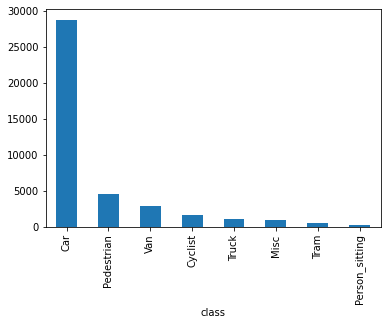

In [3]:
df.value_counts("class").plot.bar()

Large difference in datapoints between car and the rest. 

In [4]:
df["width_pixel"] = df.xmax - df.xmin
df["height_pixel"] = df.ymax - df.ymin


In [5]:
class_df = df.groupby("class")
class_df["zloc"].describe()

,count,mean,std,min,25%,50%,75%,max
class,,,,,,,,
Car,28742.0,28.012840,16.320881,-0.18,15.180,25.430,38.3300,86.18
Cyclist,1627.0,24.664487,14.443900,2.00,13.695,21.620,32.8100,78.97
Misc,973.0,29.945242,18.883033,-0.28,14.340,26.400,43.0000,84.43
Pedestrian,4487.0,17.433151,11.122100,2.05,8.930,14.690,22.4300,73.93
Person_sitting,222.0,10.525495,5.137065,2.73,6.605,9.575,13.7050,25.72
Tram,511.0,48.298552,29.080388,-0.20,25.970,41.610,73.3950,146.85
Truck,1094.0,47.149543,21.782291,-3.55,31.145,46.340,68.4325,94.44
Van,2914.0,34.669588,19.920845,-0.57,18.825,32.205,49.2325,103.60


Human objects are on average closer to the camera than vehicles.

In [6]:
class_df["height_pixel"].describe()

,count,mean,std,min,25%,50%,75%,max
class,,,,,,,,
Car,28742.0,66.121695,50.069089,12.67,30.6425,46.990,83.2075,334.53
Cyclist,1627.0,76.885575,53.016805,16.16,39.0600,60.050,97.1200,294.66
Misc,973.0,74.462559,66.519004,13.17,35.9600,51.260,85.3500,375.00
Pedestrian,4487.0,103.719405,57.420406,13.52,57.0050,87.890,146.7850,294.48
Person_sitting,222.0,102.283649,38.801185,31.74,70.4225,100.120,134.0200,226.54
Tram,511.0,104.219706,92.017494,20.18,39.2000,72.220,118.7700,374.00
Truck,1094.0,86.405530,83.355765,26.69,36.5525,59.295,89.4825,375.00
Van,2914.0,83.600216,79.797276,16.89,34.5425,52.980,94.9925,375.00


The pixel height of persons are much larger than the vehicles, this is due to most of them being closer to the camera on average.  

In [7]:
class_df["width_pixel"].describe()

,count,mean,std,min,25%,50%,75%,max
class,,,,,,,,
Car,28742.0,111.949545,90.076827,0.46,45.9700,79.700,147.9475,581.42
Cyclist,1627.0,55.849422,52.106782,6.21,22.7400,37.940,66.0550,369.83
Misc,973.0,90.717554,81.001882,5.04,35.6800,61.790,113.3100,454.02
Pedestrian,4487.0,43.816191,34.049373,0.11,20.1400,33.330,59.5850,358.42
Person_sitting,222.0,83.637658,44.736819,3.86,50.7825,69.660,106.5150,230.41
Tram,511.0,153.412505,125.242745,24.25,58.9500,96.410,224.3900,537.41
Truck,1094.0,99.720612,97.053728,1.83,39.7800,60.905,113.0225,509.91
Van,2914.0,109.652725,95.920624,3.24,42.5225,75.720,143.4925,537.01


Humans have a smaller pixel width than vehicles despite being closer to the camera. 

The largest conclusion is that the differing pixel widths and heights by class are significant between classes. This provides evidence that the class feature needs to be included, or a seperate model needs to be trained for each class. Leaning towards the former though to prevent overfitting issues. 

Furthermore, the difference between the average distance of motor vehicles and pedestrians is about 11 meters. Which seems significantly different. This alone might makes me want to experiment with models of the following different classes. 
        
    1. Pedestrian Feature only
    2. Human Features only
    3. Human Features + Car
    4. All classes
    
After training all these models, we will want to check our accuracy metrics with respect to individual classes to see if they are different depending on different feature selections. 

# Distance from Camera Analysis

Quick check to see if distribution of angles are similair accross classes, with the exception of the larger vehicles (tram, bus) they do appear to be the same with bimodal distributions. So we are good here.

In [8]:
df.zloc.describe()

count    40570.000000
mean        27.908786
std         17.440432
min         -3.550000
25%         14.200000
50%         24.520000
75%         38.327500
max        146.850000
Name: zloc, dtype: float64

In [9]:
alt.Chart(df).mark_bar().encode(
    alt.X("zloc", bin=alt.Bin(extent=[0, 120], step = 120/20)),
    y="count()",
   
).properties(
    title="Distance Histogram"
)

alt.Chart(...)

Synopsis: Maybe Remove all elements over 80 meters away away due to insuffienct data.

In [10]:
alt.Chart(df).mark_bar().encode(
    alt.X("zloc", bin=alt.Bin(extent=[0, 120], step = 120/20)),
    y="count()",
    column="class"
).properties(
    title="Distance Histogram"
)

alt.Chart(...)

Synopsis: Consider removing classes with low counts of available data

# Observation Angle Analysis

In [11]:
from math import pi

angle = -pi
tolerance= .1
disp_df = df[(df["observation angle"] < angle+tolerance) & (df["observation angle"] > angle-tolerance)].head()

disp_df.shape

(5, 19)

<AxesSubplot:title={'center':'Observation Angle Histogram'}, ylabel='Frequency'>

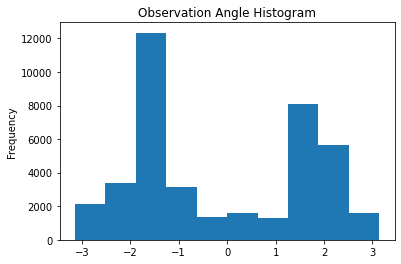

In [12]:
df["observation angle"].plot.hist(title="Observation Angle Histogram")

(18, 19)
(20, 19)


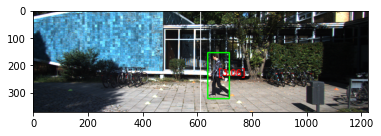

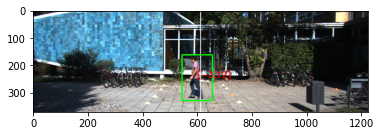

In [13]:
#pi conditions
angle = pi
conds = ((df["observation angle"] < angle+tolerance) & 
        (df["observation angle"] > angle-tolerance) &
        (df["zloc"] < 15) & 
        (df["class"] == "Pedestrian"))
pi_df = df[conds]

#negative pi conditions
angle = -pi
conds = ((df["observation angle"] < angle+tolerance) & 
        (df["observation angle"] > angle-tolerance) & 
        (df["zloc"] < 15) &
        (df["class"] == "Pedestrian"))
n_pi_df = df[conds]

print(pi_df.shape)

print(n_pi_df.shape)

#displaying both images
display_img(pi_df.iloc[0], ["angle"])
display_img(n_pi_df.iloc[0], ["angle"])

The angle of the object may impact how the distance sensor was defined, so it c

Synopsis: Angles are calculated using modular arithmetic. Meaning angles pi and -pi, which are equivilant, are numerically the furthest apart (as shown above). This needs to be addressed in one of the following ways:

    1. Take the absolute value of angle 
        - Pros:  maintains numerical datatype
        - Cons: Loses the direction the object faces
    2. Map angles to discrete directions 
        - Pros: Maintains the direction of the object 
        - Cons: Loses numerical datatype

# Angle Analysis by Class

class
Car               AxesSubplot(0.1,0.15;0.8x0.75)
Cyclist           AxesSubplot(0.1,0.15;0.8x0.75)
Misc              AxesSubplot(0.1,0.15;0.8x0.75)
Pedestrian        AxesSubplot(0.1,0.15;0.8x0.75)
Person_sitting    AxesSubplot(0.1,0.15;0.8x0.75)
Tram              AxesSubplot(0.1,0.15;0.8x0.75)
Truck             AxesSubplot(0.1,0.15;0.8x0.75)
Van               AxesSubplot(0.1,0.15;0.8x0.75)
Name: angle, dtype: object

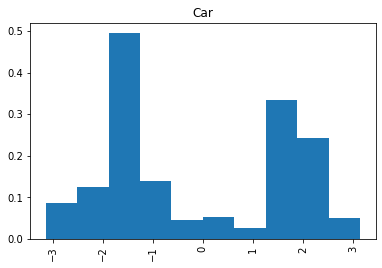

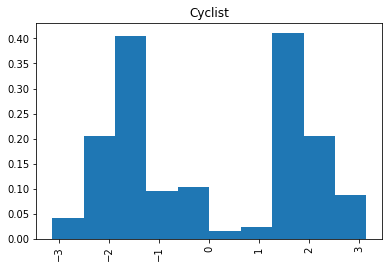

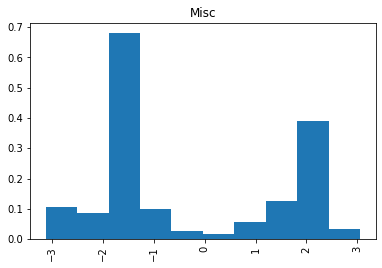

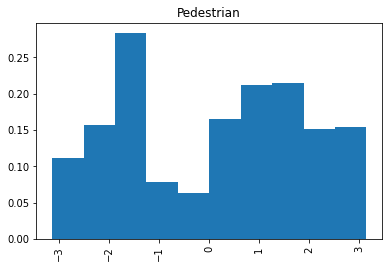

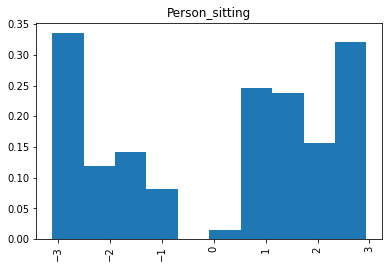

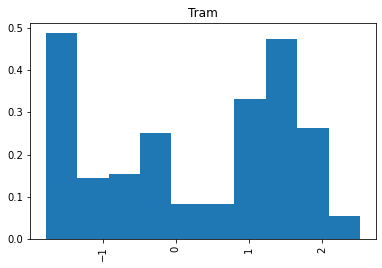

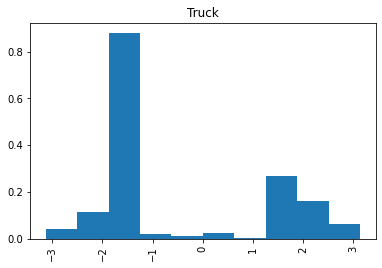

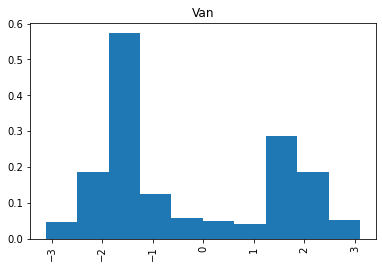

In [14]:
df.groupby("class")["angle"].hist(density=True, by=df["class"])

# Truncation Analysis

Truncation is how much of the image is removed from the image boundries

(5391, 19)


<AxesSubplot:title={'center':'Histogram of Truncated Images'}, ylabel='Frequency'>

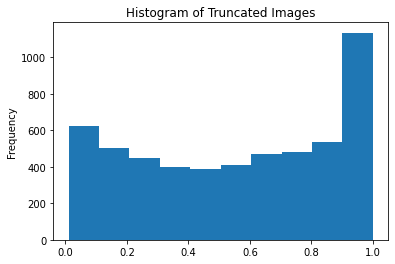

In [15]:
truncated = df[df.truncated > 0].sort_values("truncated")

print(truncated.shape)



truncated.truncated.plot.hist(title="Histogram of Truncated Images")

In [16]:
truncated_thresholds = [i/10 for i in range(1, 10)]

image_threshholds = []
print(truncated_thresholds)
for threshhold in truncated_thresholds:
    row = truncated[truncated.truncated > threshhold].iloc[0]
    image_threshholds.append(row)
    display_img(row, ["truncated"], cvshow=True)
    
print([row["truncated"] for row in image_threshholds])

[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
[0.11, 0.21, 0.31, 0.41, 0.51, 0.61, 0.71, 0.81, 0.91]


From the small snippet above, we can see that images over a certain truncation are far less visible. Removing images above a certain truncation should be considered. Furthermore, most bounding box software doesn't give a box if the image isn't fully in frame, so we may want to consider removing those as the model will be learning a situation that will likely not occur in general use of the software. 
    
    Coices to consider:
    - Remove truncation above certain threshold
    - leave it as it might be a situation to be learned

Also, as all truncated images have to be on the extreme edges of the image, it is worth considering removing images outside of extreme x coordinates. ALthough, this might be the same thing as just removing truncated items. 

# Occlusion Analysis
Occlusion categorically determines how much an image is partially obstructed from another objects view. 
States of oclusion
    
    
    0 = fully visible,
    1 = partly occluded,
    2 = largely occluded, 
    3 = unknown

In [17]:
for threshhold in range(10):
    row = df[(df.occluded ==2) & (df.zloc < 15)].iloc[threshhold]
    display_img(row, ["occluded"], cvshow=True)

After looking through these, I noticed that the occlusion metric was not attained very accurately. For example, when looking at elements of occlusion 3, some are completely blocked, some are mildly truncated, and some are barely obstructed at all. The truncated measure is much more accurate, and that is going to be what I'm going to use. Occlusion is a bunk metric.





# Conclusion

I want to test the following features in various sub variations

1. Full image array
- image within bounding box
2. pixel width
3. pixel length
4. xmin, xmax, ymin, ymax (idk how the derived pixel metrics will differ from this)
5. class
6. obvservation angle (output)

I would also like to test the data with the following subsets of class as features:
1. Pedestrian only
2. Human classes only
3. Human classes + Car
4. All classes

I'm also going to consider removing rows based on the following criteria:
1. Too far from camera (80 meters probably)
2. Too few classes (Vans, trams, etc)
3. Too Truncated (either 0 or very close to it)

I also need to transform the angle variable in one of the following 2 ways with the following pros and cons:
1. Take the absolute value of angle 
        - Pros:  maintains numerical datatype
        - Cons: Loses the direction the object faces
2. Map angles to discrete directions 
        - Pros: Maintains the direction of the object 
        - Cons: Loses numerical datatype